# about this notebook
this is copy of [EleMisi/ConditionalVAE/notebooks/Image_Generation.ipynb](https://github.com/EleMisi/ConditionalVAE/blob/master/notebooks/Image_Generation.ipynb) on github. but modified.

In [9]:
import numpy as np
#test split 4-dim numpy array
a=np.ones([2,4,4,3])
a.shape

(2, 4, 4, 3)

# Define the model

In [1]:
# Hyper-paramters
label_dim = 26
image_dim = [1024, 1024, 6]
latent_dim = 128
beta = 0.65

batch_size = 4

In [2]:
import tensorflow as tf
from elemisi_cvae.src.ConvolutionalCondVAE import ConvCVAE, Decoder, Encoder

# Model
encoder = Encoder(latent_dim)
decoder = Decoder(batch_size = batch_size)
model = ConvCVAE(
                encoder,
                decoder,
                batch_size = batch_size,
                label_dim = label_dim,
                latent_dim = latent_dim,
                beta = beta,
                image_dim = image_dim)

# Restore checkpoint 

In [3]:
import os

# Checkpoint path
checkpoint_root = "./CVAE{}_{}_checkpoint".format(latent_dim, beta)
checkpoint_name = "model"
save_prefix = os.path.join(checkpoint_root, checkpoint_name)

# Define the checkpoint
checkpoint = tf.train.Checkpoint(module=model)

In [4]:
# Restore the latest checkpoint

latest = tf.train.latest_checkpoint(checkpoint_root)
if latest is not None:
    checkpoint.restore(latest)
    print("Checkpoint restored:", latest)
else:
  print("No checkpoint!")

Checkpoint restored: ./CVAE128_0.65_checkpoint/model-2


# Read test data

In [5]:
import argparse
import json
import os
from matplotlib import pyplot as plt
import sys

import tensorflow as tf

from elemisi_cvae.src.utils import batch_generator, convert_batch_to_image_grid, read_data

# Read test_data.pickle 
test_data = read_data("./test_data")

# Saving path for generated images
folder = "./images_{}_{}_30epochs/".format(latent_dim, beta)
if not os.path.exists(folder):
    os.mkdir(folder)

# Reconstruction and Generation

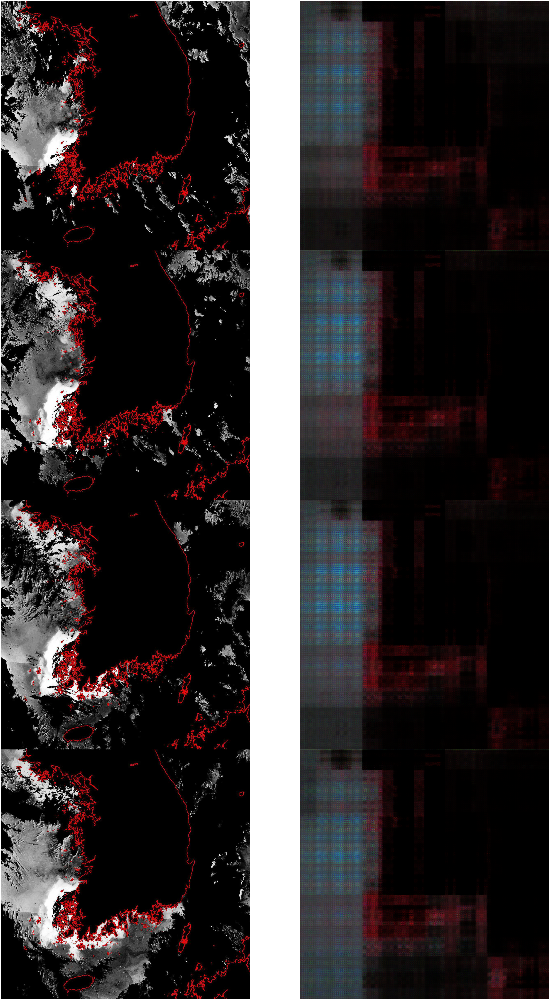

Reconstruction of a batch of test set images.
Generation of 4 images with fixed attributes.


<Figure size 432x288 with 0 Axes>

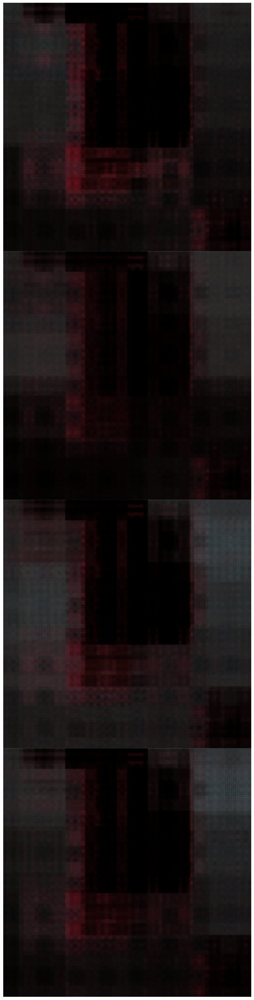

<Figure size 432x288 with 0 Axes>

In [6]:
from elemisi_cvae.src.image_generation_utils import image_generation, image_reconstruction

# Image reconstruction
image_reconstruction(model, test_data, save_path=None) 

#target_attr = None 
image_generation(model, test_data, target_attr = None, save_path = None)